# Лабораторная работа 1

### Импорт зависимостей

In [1]:
import gymnasium as gym
from stable_baselines3 import DQN
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

### Создание окружения Taxi

In [2]:
env = gym.make("Taxi-v3")

In [3]:
observation_space = env.observation_space
action_space = env.action_space

### Создание модели
В данном случае модель обучается локально на GPU

In [4]:
model = DQN("MlpPolicy", env)

### Обучение модели
100000 шагов, при меньшем количестве модель не обучается совсем

In [6]:
timestamp=100000
model.learn(total_timesteps=timestamp)
model.save("dqn_taxi")

### Визуализация результата
Код немного изменен относительно базового ноутбука для совместимости с локальным окружением

По итогам визуализации видно, что модель обучилась только не совершать действия, приводящие к большому штрафу. При этом полезные действия не совершаются, а средняя награда отрицательная из-за большой продолжительности эпизода, когда модель повторяет однотипные действия

Animation size has reached 21257658 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


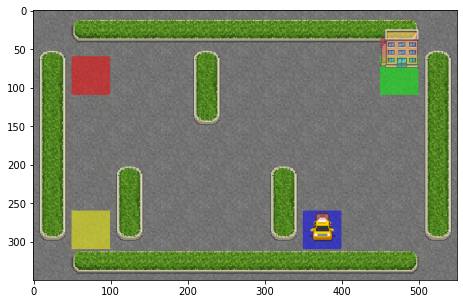

In [7]:
env = gym.make('Taxi-v3', render_mode='rgb_array')

obs = env.reset()[0]

img = []
for _ in range(100):
    action, _states = model.predict(obs, deterministic=True)
    obs, reward, terminated, truncated, _ = env.step(int(action))

    img.append(env.render())


dpi = 72
interval = 50 # ms

plt.figure(figsize=(img[0].shape[1]/dpi,img[0].shape[0]/dpi),dpi=dpi)
patch = plt.imshow(img[0])
plt.axis=('off')
animate = lambda i: patch.set_data(img[i])
ani = animation.FuncAnimation(plt.gcf(),animate,frames=len(img),interval=interval)
HTML(ani.to_jshtml())